<a href="https://colab.research.google.com/github/tevindonte/tevindonte/blob/main/Copy_of_Final_Copy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Resources

Resources for geographic visualization
https://www.youtube.com/watch?v=Yd5oEIBFQ_E&t=1495s

Dataset
https://drive.google.com/file/d/1K0M-Z89cj6-MFFtE_P2UjTFf5YkfIonN/view?usp=sharing

Reason for why bikes are returned to the same location can be used from this 2006 NYC Bike Survey-Page5
https://www1.nyc.gov/assets/planning/download/pdf/plans/transportation/bike_survey.pdf

Embedded Plotly
https://jennifer-banks8585.medium.com/how-to-embed-interactive-plotly-visualizations-on-medium-blogs-710209f93bd

# Outline

In [ ]:
'''
Understanding the data
Name                                                    Column Name

Ride ID                                                 ride_id
Rideable type (Electic or Classic)                      rideable_type
Started at                                              started_at
Ended at                                                ended_at
Start station name                                      start_station_name
Start station ID                                        start_station_id
End station name                                        end_station_name
End station ID                                          end_station_id
Start latitude                                          start_lat
Start longitude                                         start_lng
End latitude                                            end_lat
End Longitude                                           end_lng
Member or casual ride                                   member_casual


4
Pairs of stations (For a start value, what is the list of possible end stations)
iterate for all the unique stations, how many different places do they got
unique print- count how many unique
81 unique stations


COMPLETE
1)Average Weekly Distance
2)Classic bike vs electric bike
3)Average Weekly Duration of Members and Casuals per day of the week
4)Average Rides per day of the week of members and casuals
5)Distance per day of the week of casuals and members
6)Bike type count between casuals and members
7)Table of top 10 start stations
8)Table of top 10 end stations
9)Plot Start and End Locations
10)Plot Start to End Locations 
11)Average Miles
12)Rider Counts
13)look at moring vs daytimes vs evening rides
9 am       9-5         after 5
check count between 5 am to 12 pm
check count between 12 pm to 5 pm
check count between 5 pm to 9 pm
check count between 9 pm to 4 am
14)Make a grid that shows, line thicknesses of popular stations
15)average speed from start to stop station
speed = distance ÷ time
16)how many are under 10 minutes
average ratio or outliers
17)Histogram for how long people took out bikes 
X Axis would be time ride duration
Y axis would be number of people
18)how many bikes came back to the same section
on average, what ratio of bikes of bikes from a given station is returned
19)Heat map change over a day
20)some stations just biking round the area is common
find out why
21)Visually categories- where more bike rides were happening


'''

# Understanding Data | What I've Done + What I am planning to do

In [ ]:
!pip install geopandas
!pip install chart-studio
import chart_studio


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 55.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 26.7 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.4/64.4 KB 4.0 MB/s eta 0:00:00


In [ ]:
from audioop import add
from pickletools import long1
from tracemalloc import start
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly as py
import plotly.express as px
import time
import geopy 
import math
import geopandas as gpd
import folium as fl
import scipy as sp
from geopy import geocoders
from geopy import distance
from geopy.distance import geodesic
from geopy.geocoders import Nominatim as nm
from geopy.extra.rate_limiter import RateLimiter
from geopy.geocoders import ArcGIS
from math import radians
from math import radians, cos, sin, asin, sqrt
from numpy import cos, sin, arcsin, sqrt
import itertools 
import csv
import requests
import os
import seaborn as sns

In [ ]:
#Original File
original = pd.read_csv ('/content/citibike.csv', low_memory=False) 
#Shuffle Data
data = original.sample(n=300000, random_state=1).reset_index()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#cd /content/drive/MyDrive/Colab Notebooks

[Errno 20] Not a directory: '/content/drive/MyDrive/citibike.csv'
/content/drive/MyDrive/Colab Notebooks


In [ ]:
cd /content/drive/MyDrive/

/content/drive/MyDrive


In [ ]:
original = pd.read_csv('/content/drive/MyDrive/citibike.csv', low_memory=False)

In [ ]:
data = original.sample(n=1000000, random_state=1).reset_index()

In [ ]:
#convert started_at and ended_at columns to datetime types
data['started_at'] = pd.to_datetime(data['started_at'])
data['ended_at'] = pd.to_datetime(data['ended_at'])
#calculate the ride_length and create a new column for it
data['ride_duration'] = data['ended_at'] - data['started_at']

In [ ]:
#split the started_at column to have date and time separately
#convert it to string type first
data['started_at'] = data['started_at'].astype(str)
#create two new columns 
data[['start_date', 'start_time']] = data['started_at'].str.split(' ', n=1, expand=True)
#Rename Columns
data.rename(columns={'member_casual':'user_type', 'rideable_type':'bike_type'}, inplace=True)

In [ ]:
#convert these columns back to datetime type
data['start_date'] = pd.to_datetime(data['start_date'])
data['start_time'] = pd.to_datetime(data['start_time'])

In [ ]:
data = data[data['ride_duration'] > pd.Timedelta(0)]
data['ride_duration'] = data['ride_duration'].dt.total_seconds()
#converts the timedelta to seconds
data['ride_duration'] = data['ride_duration'] / 60
#converts the timedelta to minutes


<ipython-input-14-2c6845e68a88>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['ride_duration'] = data['ride_duration'].dt.total_seconds()
<ipython-input-14-2c6845e68a88>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['ride_duration'] = data['ride_duration'] / 60


In [ ]:
data.dropna(inplace=True)
data['month'] = pd.DatetimeIndex(data['start_date']).month
data['year'] = pd.DatetimeIndex(data['start_date']).year

In [ ]:
data['day_of_week'] = data['start_date'].apply(lambda x:x.weekday())
data['day_of_week'].unique()
names = {0:'Mon', 1:'Tue', 2:'Wed', 3:'Thu', 4:'Fri', 5:'Sat', 6:'Sun'}
data['day_name'] = data['day_of_week'].apply(lambda n:names[n])

In [ ]:
#subgroup the users into separate dataframes
members = data[data['user_type'] == 'member']
casuals = data[data['user_type'] == 'casual']

In [ ]:
#average ride_length for each category
avg_ridelen_mem = members['ride_duration'].mean()
avg_ridelen_mem

avg_ridelen_cas = casuals['ride_duration'].mean()
avg_ridelen_cas

ridetable = data.pivot_table(values='ride_id', index='day_of_week', columns='user_type', aggfunc={'ride_id':'count'}) #Sort Table
table = data.pivot_table(values='ride_duration', index='day_of_week', columns='user_type') #Create an organized table
user_count = data['user_type'].value_counts()


In [ ]:
#Plotly Pie Chart Customization
Labels=['Member', 'Casual'] #Create Pie Chart Labels
figchart = px.pie(user_count, 
values=user_count,
 names=Labels,
 title='Types of Riders')
figchart.update_traces(textposition='inside', textinfo='value+label+percent')
#figchart.show()

In [ ]:
import chart_studio.plotly as cpy
import chart_studio.tools as ctls
cpy.plot(figchart, filename="CitibikePieChart", auto_open = True)


'https://plotly.com/~jmcanboy/1/'

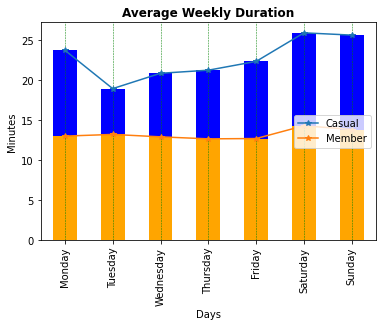

In [ ]:
table['casual'].plot(kind='bar', color='blue')
table['member'].plot(kind='bar', color='orange')
plt.rcParams['figure.figsize'] = [8,8]
plt.plot(table, marker='*')
plt.ylabel('Minutes')
plt.xlabel('Days')
plt.grid(axis = 'x',color = 'green', linestyle = '--', linewidth = 0.5)
plt.title('Average Weekly Duration', fontsize='large', fontweight='bold')
plt.legend(['Casual', 'Member'], loc='center right')
label1 = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
plt.xticks(table.index, label1)
plt.show()

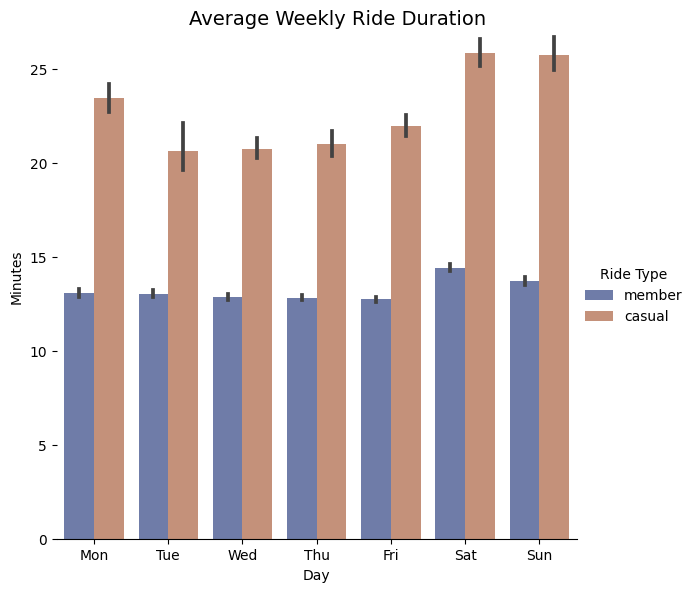

In [ ]:
g = sns.catplot(
    data=data, kind="bar",
    x="day_name", y="ride_duration", hue="user_type", palette="dark", alpha=.6, height=6, order=['Mon','Tue','Wed','Thu','Fri','Sat','Sun']
)
g.figure.suptitle(
    "Average Weekly Ride Duration",
    fontsize=14,
    fontdict={"weight": "bold"}
);
g.despine(left=True)
g.set_axis_labels("Day", "Minutes")
g.legend.set_title("Ride Type")

In [ ]:
members[members['ride_duration']>900]

In [ ]:
casuals[casuals['ride_duration']>900]

In [ ]:
rideminusoutliers=data[data['ride_duration']<30]
rideminusoutliers.shape

(902227, 21)

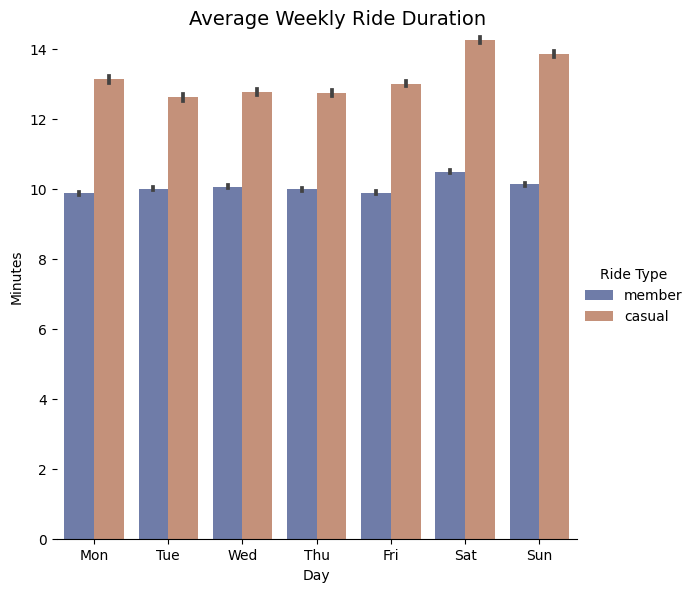

In [ ]:
g = sns.catplot(
    data=rideminusoutliers, kind="bar",
    x="day_name", y="ride_duration", hue="user_type", palette="dark", alpha=.6, height=6, order=['Mon','Tue','Wed','Thu','Fri','Sat','Sun']
)
g.figure.suptitle(
    "Average Weekly Ride Duration",
    fontsize=14,
    fontdict={"weight": "bold"}
);
g.despine(left=True)
g.set_axis_labels("Day", "Minutes")
g.legend.set_title("Ride Type")

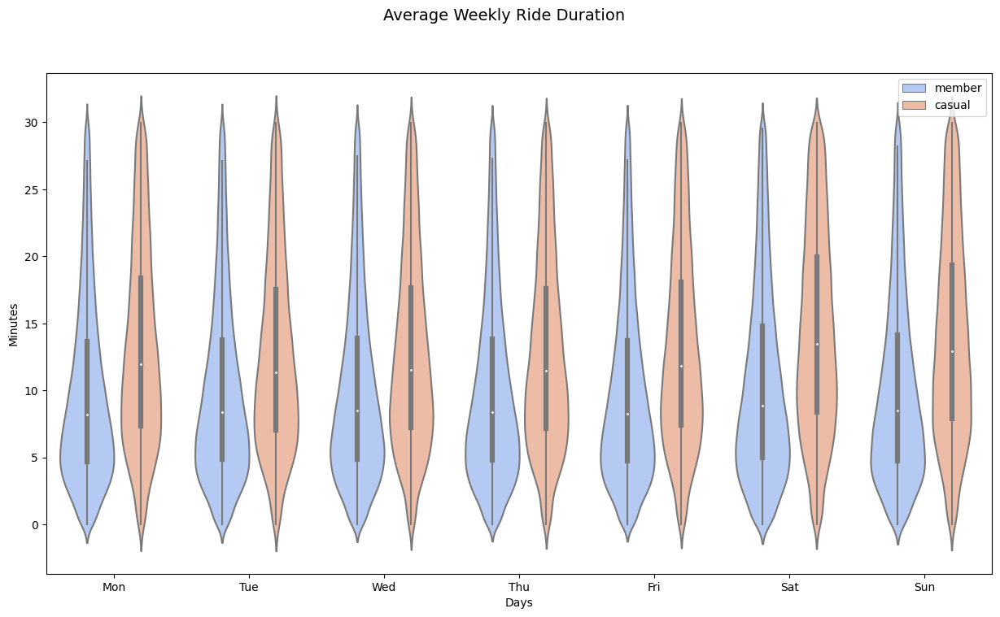

In [ ]:
plt.figure(figsize=(15,8))

graph1 = sns.violinplot(data=rideminusoutliers, x="day_name", y="ride_duration", hue="user_type", palette='coolwarm', order=['Mon','Tue','Wed','Thu','Fri','Sat','Sun'])
graph1.figure.suptitle(
    "Average Weekly Ride Duration",
    fontsize=14,
    fontdict={"weight": "bold"}
);
plt.ylabel('Minutes')
plt.xlabel('Days')
plt.legend(loc='upper right')


In [ ]:
#NOTE: You will want to use groupby to get a better sense of summary data, and how things affect one another.

data.groupby(['user_type','day_name']).agg({'ride_duration':['mean','median','min','max']})

ride_duration                                   
                            mean     median       min           max
user_type day_name                                                 
casual    Fri          21.990673  13.900000  0.016667   5470.933333
          Mon          23.452181  14.400000  0.016667   4684.850000
          Sat          25.849942  16.933333  0.016667   9166.383333
          Sun          25.764954  16.183333  0.016667   7266.933333
          Thu          20.986684  13.300000  0.016667   6369.183333
          Tue          20.655751  13.050000  0.016667  12587.233333
          Wed          20.764860  13.283333  0.016667   1454.283333
member    Fri          12.741654   8.883333  0.016667   1495.783333
          Mon          13.081149   8.800000  0.016667   1426.983333
          Sat          14.429078   9.866667  0.016667   1448.033333
          Sun          13.705135   9.283333  0.016667   1389.266667
          Thu          12.837532   8.950000  0.016667   1425.050000
          Tue          13.045977   8.983333  0.016667   1431.383333
          Wed          12.878347   9.050000  0.016667   1444.216667

In [ ]:
rideminusoutliers.groupby(['user_type','day_name']).agg({'ride_duration':['mean','median','min','max']})

ride_duration                                
                            mean     median       min        max
user_type day_name                                              
casual    Fri          12.998403  11.800000  0.016667  29.983333
          Mon          13.125211  11.933333  0.016667  29.983333
          Sat          14.255186  13.466667  0.016667  29.983333
          Sun          13.840950  12.950000  0.016667  29.983333
          Thu          12.734570  11.466667  0.016667  29.983333
          Tue          12.609216  11.333333  0.016667  29.983333
          Wed          12.770536  11.533333  0.016667  29.983333
member    Fri           9.891161   8.266667  0.016667  29.983333
          Mon           9.869455   8.200000  0.016667  29.983333
          Sat          10.485158   8.866667  0.016667  29.983333
          Sun          10.123196   8.466667  0.016667  29.983333
          Thu           9.981834   8.366667  0.016667  29.983333
          Tue           9.994297   8.400000  0.016667  29.983333
          Wed          10.054399   8.466667  0.016667  29.983333

In [ ]:
data.groupby(['user_type'])['ride_duration'].describe()

,count,mean,std,min,25%,50%,75%,max
user_type,,,,,,,,
casual,231332.0,23.065858,70.420203,0.016667,8.450000,14.566667,24.866667,12587.233333
member,766073.0,13.165648,28.139686,0.016667,5.066667,9.066667,15.900000,1495.783333


In [ ]:
#subgroup the users into separate dataframes
membersminusoutliers = rideminusoutliers[rideminusoutliers['user_type'] == 'member']
casualsminusoutliers = rideminusoutliers[rideminusoutliers['user_type'] == 'casual']

In [ ]:
from scipy import stats


# Member vs Casual Ride Duration TTest

In [ ]:
#basic example of what's called a t-test, used to compare numerical data.  Can compare 2 categories
from scipy.stats import ttest_ind
ttest_ind(members['ride_duration'], casuals['ride_duration'])

Ttest_indResult(statistic=-59.05876454502487, pvalue=0.0)

In [ ]:
ttest_ind(membersminusoutliers[membersminusoutliers['day_name']=='Sat']['ride_duration'], membersminusoutliers[membersminusoutliers['day_name']=='Thu']['ride_duration'])

Ttest_indResult(statistic=12.114585722404275, pvalue=9.573861355191639e-34)

# Comparing Day + Ride Duration of Casuals & Members

In [ ]:
#If you want to compare more than two categories, you have to use something called ANOVA
fvalue, pvalue = stats.f_oneway(members[members['day_name']=='Mon']['ride_duration'], members[members['day_name']=='Tue']['ride_duration'],members[members['day_name']=='Wed']['ride_duration'], members[members['day_name']=='Thu']['ride_duration'],members[members['day_name']=='Fri']['ride_duration'])
print(fvalue, pvalue)
#The fact that pvalue is over 0.05 shows that there is no stat sig difference in member bike rides on diff weekdays

2.310618257119068 0.055320717103637895


In [ ]:
#Now we include weekends.
fvalue, pvalue = stats.f_oneway(members[members['day_name']=='Mon']['ride_duration'], members[members['day_name']=='Tue']['ride_duration'],members[members['day_name']=='Wed']['ride_duration'], members[members['day_name']=='Thu']['ride_duration'],members[members['day_name']=='Fri']['ride_duration'],members[members['day_name']=='Sat']['ride_duration'],members[members['day_name']=='Sun']['ride_duration'])
print(fvalue, pvalue)
#Now the pvalue is 10^(-17), a MUCH smaller number indicating that there is a difference when we include weekends.

15.217853548286316 1.6347552645971713e-17


# Comparing Day + Start times of Casuals & Members

In [ ]:
#Comparing members start time during week day vs the week(including weekend) ANOVA
fvalue, pvalue = stats.f_oneway(members[members['day_name']=='Mon']['start_time'], members[members['day_name']=='Tue']['start_time'], members[members['day_name']=='Wed']['start_time'], members[members['day_name']=='Thu']['start_time'], members[members['day_name']=='Fri']['start_time'])
print(fvalue, pvalue)

15.768763634171881 6.577795419614441e-13


In [ ]:
#Including Weekend
fvalue, pvalue = stats.f_oneway(members[members['day_name']=='Mon']['start_time'], members[members['day_name']=='Tue']['start_time'], members[members['day_name']=='Wed']['start_time'], members[members['day_name']=='Thu']['start_time'], members[members['day_name']=='Fri']['start_time'], members[members['day_name']=='Sat']['start_time'], members[members['day_name']=='Sun']['start_time'])
print(fvalue, pvalue)
#Theres a difference within the start times for members during week days and weekends

66.82882419989984 2.0495422440992465e-83


In [ ]:
#Comparing members start time during week day vs the week(including weekend) ANOVA
fvalue, pvalue = stats.f_oneway(casuals[casuals['day_name']=='Mon']['start_time'], casuals[casuals['day_name']=='Tue']['start_time'], casuals[casuals['day_name']=='Wed']['start_time'], casuals[casuals['day_name']=='Thu']['start_time'], casuals[casuals['day_name']=='Fri']['start_time'])
print(fvalue, pvalue)

21.20074001493016 1.7350399228606894e-17


In [ ]:
#Including Weekend
fvalue, pvalue = stats.f_oneway(casuals[casuals['day_name']=='Mon']['start_time'], casuals[casuals['day_name']=='Tue']['start_time'], casuals[casuals['day_name']=='Wed']['start_time'], casuals[casuals['day_name']=='Thu']['start_time'], casuals[casuals['day_name']=='Fri']['start_time'], casuals[casuals['day_name']=='Sat']['start_time'], casuals[casuals['day_name']=='Sun']['start_time'])
print(fvalue, pvalue)
#Theres a difference within the start times for members during week days and weekends

147.84337219843778 3.828619017904232e-187


In [ ]:
rideminusoutliers.columns

Index(['index', 'ride_id', 'bike_type', 'started_at', 'ended_at',
       'start_station_name', 'start_station_id', 'end_station_name',
       'end_station_id', 'start_lat', 'start_lng', 'end_lat', 'end_lng',
       'user_type', 'ride_duration', 'start_date', 'start_time', 'month',
       'year', 'day_of_week', 'day_name'],
      dtype='object')

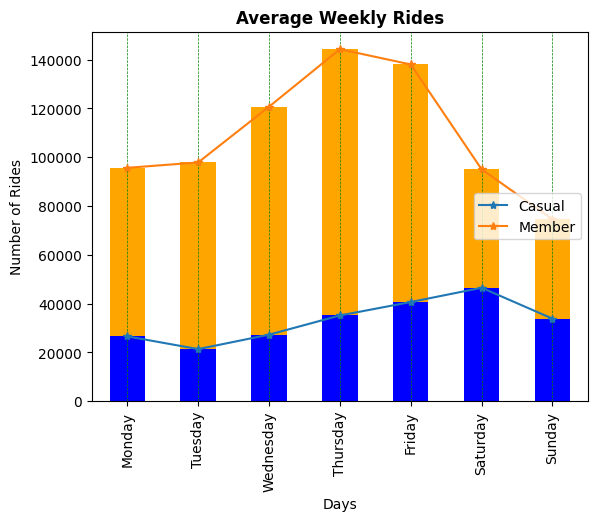

In [ ]:
ridetable['member'].plot(kind='bar', color='orange')
ridetable['casual'].plot(kind='bar', color='blue')
plt.rcParams['figure.figsize'] = [10,10]
plt.plot(ridetable, marker='*')
plt.ylabel('Number of Rides')
plt.xlabel('Days')
avweekly=plt.grid(axis = 'x',color = 'green', linestyle = '--', linewidth = 0.5)
plt.title('Average Weekly Rides', fontsize='large', fontweight='bold')
plt.legend(['Casual', 'Member'], loc='center right')
label2 = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
plt.xticks(ridetable.index, label2)
plt.show()

Text(0.5, 1.0, 'Average Weekly Rides')

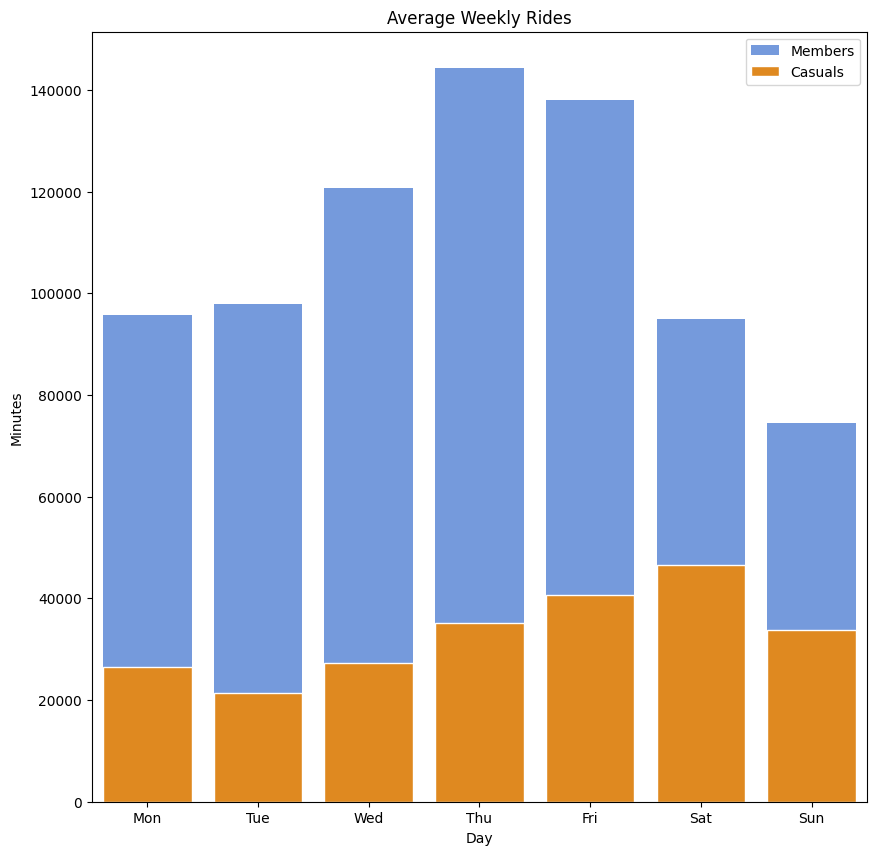

In [ ]:
y = sns.countplot(
    x=members["day_name"],
    color='cornflowerblue',
    order=['Mon','Tue','Wed','Thu','Fri','Sat','Sun'],

    
    
    )
y.legend(labels = ['Members']) 
y.set(xlabel='Day', ylabel='Minutes')


p = sns.countplot(
    x=casuals["day_name"],
    color='darkorange',
    edgecolor="white",
    order=['Mon','Tue','Wed','Thu','Fri','Sat','Sun'],
    
    )
p.legend(labels = ['Members', 'Casuals']) 
p.set(xlabel='Day', ylabel='Minutes')
plt.title("Average Weekly Rides")

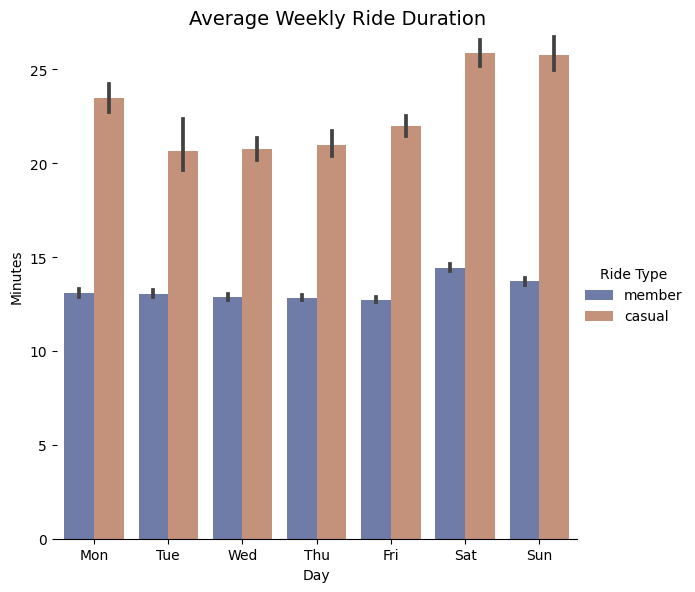

In [ ]:
g = sns.catplot(
    data=data, kind="bar",
    x="day_name", y="ride_duration", hue="user_type", palette="dark", alpha=.6, height=6, order=['Mon','Tue','Wed','Thu','Fri','Sat','Sun']
)
g.figure.suptitle(
    "Average Weekly Ride Duration",
    fontsize=14,
    fontdict={"weight": "bold"}
);
g.despine(left=True)
g.set_axis_labels("Day", "Minutes")
g.legend.set_title("Ride Type")

In [ ]:
startlatitude = np.array(data['start_lat'])  #Numpy array of start latitude
endlatitude = np.array(data['end_lat']) #Numpy Array of End Latitude
startlongitude = np.array(data['start_lng']) #Numpy array of start longitude
endlongitude = np.array(data['end_lng']) #Numpy Array of end location longitude
startdf = pd.DataFrame({"StartLatitude" : startlatitude, "StartLongitude" : startlongitude}) #Convert Start location array to dataframe
#startdf.to_csv("Startlocation.csv", index=False) #Convert Start location Dataframe to csv
enddf = pd.DataFrame({"EndLatitude" : endlatitude, "EndLongitude" : endlongitude}) #Convert End location array to dataframe
#enddf.to_csv("EndLocation.csv", index=False) #Convert End location to csv
BothLocations = pd.concat([startdf, enddf], axis=1) #Combined both Locations into one dataframe
#BothLocations.to_csv("EndLocation.csv", index=False) #Convert Both Locations to csv

f = pd.DataFrame(startdf)
f1= pd.DataFrame(enddf)
result1 = pd.concat([f, f1], axis=1)

In [ ]:
#Average Miles
data['lat1'] = np.radians(data['start_lat'].astype(float)) #Converting to float = twice because of error
data['lat1'].apply(lambda x: float(x)) #Converting to float = twice because of error
data['lat2'] = np.radians(data['end_lat'].astype(float)) #Converting to float = twice because of error
data['lat2'].apply(lambda x: float(x)) #Converting to float = twice because of error
data['long1'] = np.radians(data['start_lng'].astype(float)) #Converting to float = twice because of error
data['long1'].apply(lambda x: float(x)) #Converting to float = twice because of error
data['long2'] = np.radians(data['end_lng'].astype(float)) #Converting to float = twice because of error
data['long2'].apply(lambda x: float(x)) #Converting to float = twice because of error
(data.start_lat).apply(lambda x: float(x)) #Converting to float = twice because of error

0         40.741459
1         40.727086
2         40.720528
3         40.740983
4         40.723957
            ...    
999995    40.745686
999996    40.730311
999997    40.738663
999998    40.705484
999999    40.741740
Name: start_lat, Length: 997405, dtype: float64

In [ ]:
# Haversine formula
data['dlat'] = data['lat2'] - data['lat1']
data['dlong']= data['long2'] - data['long1']
data['test']=data['dlat'] / 2
a = sin(data['dlat'] / 2)**2 + cos(data['lat1']) * cos(data['lat2']) * sin(data['dlong']/ 2)**2
c = (2* np.arcsin(sqrt(a)))
r = 3956 # Radius of earth in kilometers. Use 3956 for miles
miles=c*r # calculate the result
data['miles']=miles #Create Dataframe
averagemiles=data['miles'].mean() #Save the average/mean
averagemiles

1.161709595935531

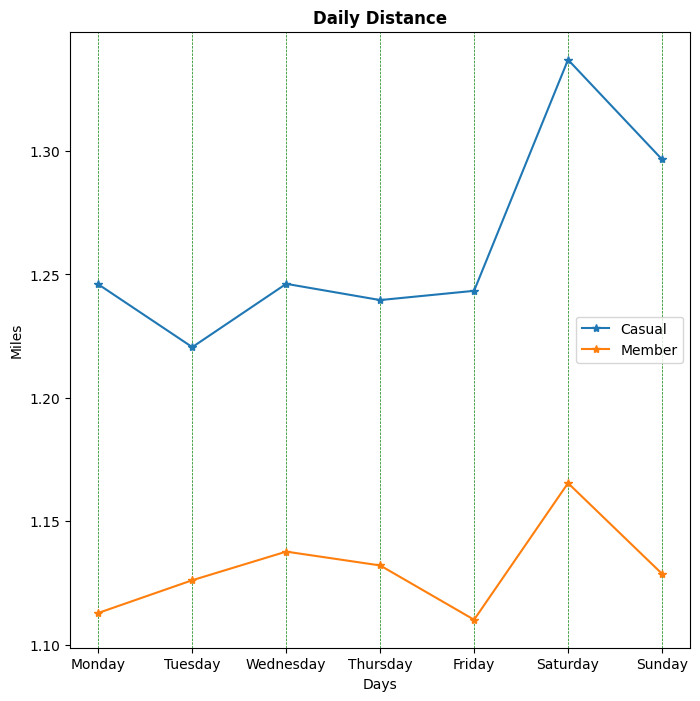

In [ ]:
averagemilesperweek = data.pivot_table(values='miles', index='day_of_week') #Create an organized table
averagemilesperweek2 = data.pivot_table(values='miles', index='day_of_week', columns='user_type')
plt.rcParams['figure.figsize'] = [8,8]
plt.plot(averagemilesperweek2, marker='*')
#plt.axhline(y=averagemiles, color='gray', linestyle='-')
plt.ylabel('Miles')
plt.xlabel('Days')
plt.grid(axis = 'x',color = 'green', linestyle = '--', linewidth = 0.5)
plt.title('Daily Distance', fontsize='large', fontweight='bold')
plt.legend(['Casual', 'Member', 'Average'], loc='center right')
label3 = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
avmiles=plt.xticks(ridetable.index, label3)
plt.show()

In [ ]:
averagemilesperweek2

user_type,casual,member
day_of_week,,
0,1.245982,1.112822
1,1.220540,1.126078
2,1.246189,1.137669
3,1.239609,1.132068
4,1.243357,1.110071
5,1.337010,1.165438
6,1.296653,1.128709


Text(0.5, 1.0, 'Weekly Distance')

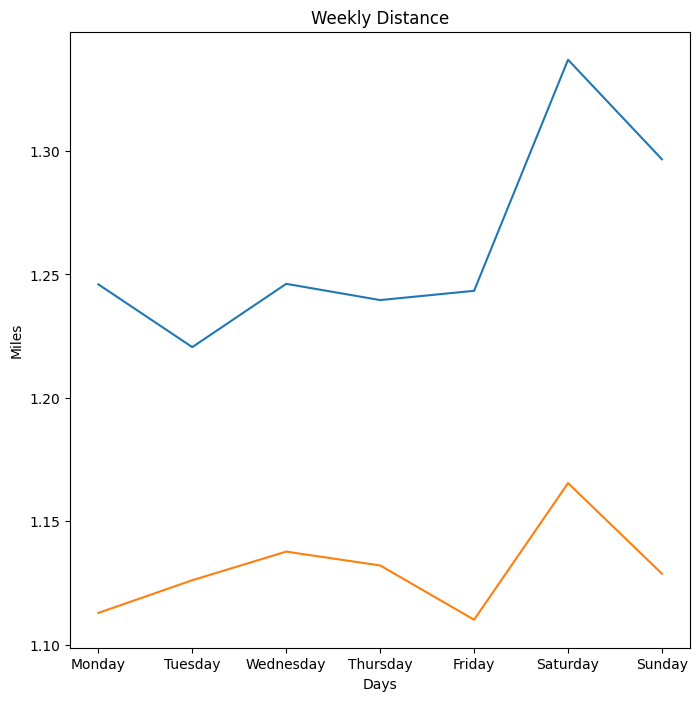

In [ ]:
vc = sns.lineplot(data=averagemilesperweek2, x="day_of_week", y="casual")

vm = sns.lineplot(data=averagemilesperweek2, x="day_of_week", y="member")
label3 = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
avmiles=plt.xticks(ridetable.index, label3)
plt.ylabel('Miles')
plt.xlabel('Days')
plt.title("Weekly Distance")

In [ ]:
#Miles Analysis over User_type
data.groupby(['user_type'])['miles'].describe()

,count,mean,std,min,25%,50%,75%,max
user_type,,,,,,,,
casual,231332.0,1.267934,1.051334,0.0,0.586845,1.011922,1.672129,13.392380
member,766073.0,1.129633,1.050085,0.0,0.441690,0.824748,1.477583,15.093404


In [ ]:
from statsmodels.tools.sm_exceptions import ModelWarning
data['started_at'] = pd.to_datetime(data['started_at'], errors='coerce')
data['hour'] = data['started_at'].dt.hour
def f(x):
    if (x > 4) and (x <= 8):
        return 'Early Morning'
    elif (x > 8) and (x <= 12 ):
        return 'Morning'
    elif (x > 12) and (x <= 16):
        return'Noon'
    elif (x > 16) and (x <= 20) :
        return 'Eve'
    elif (x > 20) and (x <= 24):
        return'Night'
    elif (x <= 4):
        return'Late Night'
data['session1'] = data['hour'].apply(f)



In [ ]:
earlym=data[data['session1']=='Early Morning']
early=(len(earlym))
morni=data[data['session1']=='Morning']
morn=(len(morni))
afterno=data[data['session1']=='Noon']
after=(len(afterno))
Even=data[data['session1']=='Eve']
eve=(len(Even))
Nighty=data[data['session1']=='Night']
night=(len(Nighty))

In [ ]:
df = pd.DataFrame({'Time':['Early Morning','Morning','Afternoon','Evening','Night'],
                   'Count':[early,morn,after,eve,night],
                   })
df

,Time,Count
0,Early Morning,123108
1,Morning,195828
2,Afternoon,264203
3,Evening,293795
4,Night,84740


In [ ]:
fig = px.bar(df, x='Time', y='Count', title="Rider Start Times")
fig.show()
fig.write_image("fig1.png")

ValueError: ignored

In [ ]:
import chart_studio.plotly as cpy
import chart_studio.tools as ctls
cpy.plot(fig, filename="CitibikeBar", auto_open = True)

'https://plotly.com/~jmcanboy/5/'

Text(0.5, 1.0, 'Rideable Type for Casual Riders vs Members')

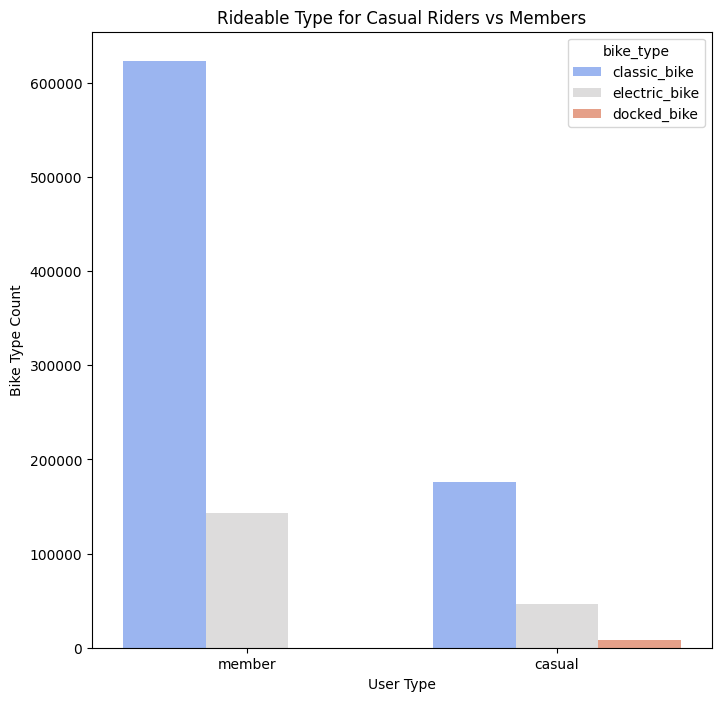

In [ ]:
#number of rides for each user type by rideable_type
ridecount_ptype_mem = members.groupby('user_type')['ride_id'].count()
ridecount_ptype_cas = casuals.groupby('user_type')['ride_id'].count()
import seaborn as sns
t= sns.countplot(x='user_type', hue='bike_type', palette="coolwarm", data=data)
t.set(xlabel='User Type', ylabel='Bike Type Count')
plt.title("Rideable Type for Casual Riders vs Members")

In [ ]:
#Map ScatterBox for the Starting Locations
fig=px.scatter_mapbox(data, lon = startlongitude,
                              lat = startlatitude,
                              zoom=10 ,
                              width=1200,
                              height=900,
                              title='Start locations',
                              
                              
                              )
fig.update_layout(mapbox_style='open-street-map')
fig.show()

In [ ]:
scatterend = px.scatter_mapbox(data, lon = endlongitude,
                              lat = endlatitude,
                              zoom=10 ,
                              width=1200,
                              height=900,
                              title='End locations'
                              )
scatterend.update_layout(mapbox_style='open-street-map')
scatterend.show()


KeyboardInterrupt: ignored

In [ ]:
data['end_station_id'].unique().size

1637

In [ ]:
season=data['start_station_name'].value_counts()
season=season.head(20)
season

West St & Chambers St      4249
W 21 St & 6 Ave            4233
Broadway & W 58 St         4071
Central Park S & 6 Ave     3630
6 Ave & W 33 St            3471
Broadway & W 25 St         3382
Lafayette St & E 8 St      3229
West St & Liberty St       3201
1 Ave & E 68 St            3155
University Pl & E 14 St    3144
12 Ave & W 40 St           3019
Broadway & W 29 St         3009
6 Ave & W 34 St            2986
W 31 St & 7 Ave            2954
8 Ave & W 16 St            2950
E 17 St & Broadway         2904
E 33 St & 1 Ave            2845
E 40 St & Park Ave         2843
10 Ave & W 14 St           2822
W 22 St & 10 Ave           2822
Name: start_station_name, dtype: int64

In [ ]:
endseason=data['end_station_name'].value_counts()
ends=endseason.head(20)
ends

W 21 St & 6 Ave            4289
West St & Chambers St      4242
Broadway & W 58 St         3872
Central Park S & 6 Ave     3678
6 Ave & W 33 St            3421
Broadway & W 25 St         3283
University Pl & E 14 St    3211
West St & Liberty St       3194
12 Ave & W 40 St           3180
1 Ave & E 68 St            3178
Lafayette St & E 8 St      3174
Broadway & W 29 St         3020
8 Ave & W 16 St            2937
E 33 St & 1 Ave            2909
W 31 St & 7 Ave            2904
E 17 St & Broadway         2896
6 Ave & W 34 St            2849
Broadway & E 21 St         2817
W 22 St & 10 Ave           2816
Broadway & E 14 St         2812
Name: end_station_name, dtype: int64

In [ ]:
import plotly.graph_objects as go
fpp = pd.DataFrame(season)
f=fpp.head(5)
f['Start Station Name'] = f.index
f = f.rename(columns={'start_station_name': 'Count'})
fig = px.bar(f, x='Start Station Name', y='Count', title="Popular Start Stations")

dff = pd.DataFrame(ends)
d=dff.head(5)
d['End Station Name'] = d.index
d = d.rename(columns={'end_station_name': 'Count'})
fig1 = px.bar(d, x='End Station Name', y='Count', title="Popular End Stations", color_discrete_sequence=['orange'])

fig2 = go.Figure(data = fig1.data + fig.data)
fig2.update_layout(
title="Popular Start and End Stations",
)
fig2.update_xaxes(title_text='Station Names')
fig2.update_yaxes(title_text='Count')
fig2.update_layout(showlegend=True)
fig2.show()


<ipython-input-88-017f1a06044b>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-88-017f1a06044b>:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
make=data['end_station_name'].value_counts()
make.head(10)

W 21 St & 6 Ave            4289
West St & Chambers St      4242
Broadway & W 58 St         3872
Central Park S & 6 Ave     3678
6 Ave & W 33 St            3421
Broadway & W 25 St         3283
University Pl & E 14 St    3211
West St & Liberty St       3194
12 Ave & W 40 St           3180
1 Ave & E 68 St            3178
Name: end_station_name, dtype: int64

In [ ]:
#f d season ends
combinator = pd.concat([f, d], axis=1)
thefirst=combinator.head(17)
combinator

,Count,Start Station Name,Count,End Station Name
West St & Chambers St,4249.0,West St & Chambers St,4242.0,West St & Chambers St
W 21 St & 6 Ave,4233.0,W 21 St & 6 Ave,4289.0,W 21 St & 6 Ave
Broadway & W 58 St,4071.0,Broadway & W 58 St,3872.0,Broadway & W 58 St
Central Park S & 6 Ave,3630.0,Central Park S & 6 Ave,3678.0,Central Park S & 6 Ave
6 Ave & W 33 St,3471.0,6 Ave & W 33 St,3421.0,6 Ave & W 33 St
Broadway & W 25 St,3382.0,Broadway & W 25 St,3283.0,Broadway & W 25 St
Lafayette St & E 8 St,3229.0,Lafayette St & E 8 St,NaN,NaN
West St & Liberty St,3201.0,West St & Liberty St,3194.0,West St & Liberty St
1 Ave & E 68 St,3155.0,1 Ave & E 68 St,3178.0,1 Ave & E 68 St
University Pl & E 14 St,3144.0,University Pl & E 14 St,3211.0,University Pl & E 14 St


In [ ]:
thefirst

,Count,Start Station Name,Count,End Station Name
West St & Chambers St,4249.0,West St & Chambers St,4242.0,West St & Chambers St
W 21 St & 6 Ave,4233.0,W 21 St & 6 Ave,4289.0,W 21 St & 6 Ave
Broadway & W 58 St,4071.0,Broadway & W 58 St,3872.0,Broadway & W 58 St
Central Park S & 6 Ave,3630.0,Central Park S & 6 Ave,3678.0,Central Park S & 6 Ave
6 Ave & W 33 St,3471.0,6 Ave & W 33 St,3421.0,6 Ave & W 33 St
Broadway & W 25 St,3382.0,Broadway & W 25 St,3283.0,Broadway & W 25 St
Lafayette St & E 8 St,3229.0,Lafayette St & E 8 St,NaN,NaN
West St & Liberty St,3201.0,West St & Liberty St,3194.0,West St & Liberty St
1 Ave & E 68 St,3155.0,1 Ave & E 68 St,3178.0,1 Ave & E 68 St
University Pl & E 14 St,3144.0,University Pl & E 14 St,3211.0,University Pl & E 14 St


In [ ]:
fig = px.bar(combinator, x=combinator.index, y='sstation_count', title="Popular Start Stations")
fig.show()

ValueError: ignored

In [ ]:
#m / s
data['speed']=data['ride_duration']/data['miles']
average=data['ride_duration'].mean()
average2=data['miles'].mean()
averagespeed=average/average2
mph=averagespeed*2.23694
x=round(mph, 2)
print('The average speed: ', x, 'mph')


The average speed:  29.74 mph


In [ ]:
lessthan10=sum(data['ride_duration'] < 10)
greaterthan10=sum(data['ride_duration'] > 10)
ratio = (lessthan10/greaterthan10)
ratio
#Nearly Half is less than 10 minutes

0.9768887419408167

In [ ]:
fig2 = px.histogram(data, x="ride_duration", range_x=[0, 120], title='Distribution of Ride Duration(mintes) and frequency')
fig2.show()
fig2.savefig('books_read.png')

AttributeError: ignored

Text(0.5, 1.0, 'Distribution of Ride Duration(minutes) and frequency')

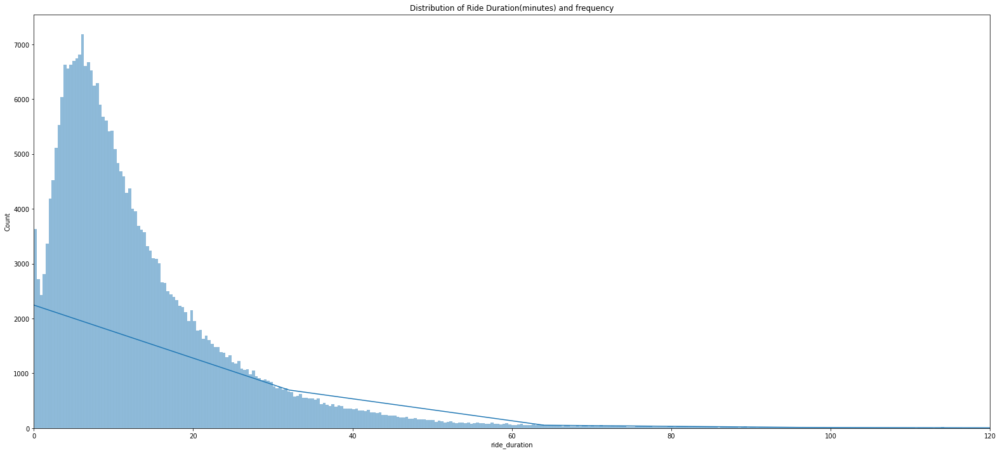

In [ ]:
fig, tx = plt.subplots(figsize=(27, 12))
ax = sns.histplot(data=data, x="ride_duration", kde=True, ax=tx)
ax.set_xlim(0,120)
plt.title("Distribution of Ride Duration(minutes) and frequency")


In [ ]:
checker=data[['start_station_name', 'end_station_name']]
checker['Truth Value']=data['start_station_name']==data['end_station_name']
sum(checker['Truth Value'])
checker['Truth Value'].value_counts()
comeback=(sum(checker['Truth Value']) / checker['Truth Value'].size) * 100
t=round(comeback, 2)
print("On average", t, "% of the bikes that are taken are returned to the same station.")

<ipython-input-62-daf203eeb34a>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



On average 5.45 % of the bikes that are taken are returned to the same station.


In [ ]:
#Residential Areas & Nearby Parks
#Further study on same start and end location
samesta=data[(data.start_station_name == data.end_station_name)]
stationval=samesta['start_station_name'].value_counts()
stationval.head(20)

Central Park S & 6 Ave         191
Broadway & W 58 St              89
Soissons Landing                85
Roosevelt Island Tramway        82
West St & Chambers St           76
7 Ave & Central Park South      76
12 Ave & W 40 St                73
Broadway & W 41 St              72
Central Park West & W 68 St     68
5 Ave & E 72 St                 66
Yankee Ferry Terminal           65
Central Park West & W 72 St     59
5 Ave & E 87 St                 58
West St & Liberty St            55
5 Ave & E 93 St                 53
Centre St & Chambers St         53
1 Ave & E 68 St                 52
W 22 St & 10 Ave                50
W 54 St & 11 Ave                48
W 13 St & 5 Ave                 46
Name: start_station_name, dtype: int64

In [ ]:
data.replace([np.inf, -np.inf], np.nan, inplace=True)
# Drop rows with NaN
data.dropna(inplace=True)

In [ ]:
rawunique = pd.read_csv('/content/drive/MyDrive/test.csv', low_memory=False)
rawborough = pd.read_csv('/content/drive/MyDrive/outputoftest.csv', low_memory=False)

In [ ]:
resulting = pd.concat([rawunique, rawborough], axis=1)

In [ ]:
resulting.columns
resulting.drop(columns='Unnamed: 0')

,start_station_name,start_lat,start_lng,Boroughs
0,1 Ave & E 110 St,40.792331,-73.938271,Manhattan
1,1 Ave & E 16 St,40.732225,-73.981656,Manhattan
2,1 Ave & E 18 St,40.733839,-73.980532,Manhattan
3,1 Ave & E 30 St,40.741455,-73.975355,Manhattan
4,1 Ave & E 39 St,40.747162,-73.971117,Manhattan
...,...,...,...,...
1610,Wyckoff Av & Stanhope St,40.703538,-73.917814,Brooklyn
1611,Wyckoff Ave & Gates Ave,40.699861,-73.911708,Queens County
1612,Wyckoff St & Nevins St,40.683391,-73.984190,Kings County
1613,Wythe Ave & Metropolitan Ave,40.717038,-73.963172,Brooklyn


In [ ]:
dictionary=resulting.set_index('start_station_name')['Boroughs'].to_dict()
data['startborough'] = data['start_station_name'].map(dictionary)
data['endborough'] = data['end_station_name'].map(dictionary)

In [ ]:
data

,index,ride_id,bike_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,...,long2,dlat,dlong,test,miles,hour,session1,speed,startborough,endborough
0,2940534,AF5141CB7DE528C3,classic_bike,2022-09-09 18:42:34,2022-09-09 18:47:22,Lexington Ave & E 26 St,6089.08,E 20 St & 2 Ave,5971.08,40.741459,...,-1.291230,-0.000097,0.000022,-0.000049,0.390870,18,Eve,12.280284,Manhattan,Manhattan
1,1835333,61328A0B41D9DCD0,electric_bike,2022-09-14 19:56:53,2022-09-14 20:03:39,Meserole Ave & Manhattan Ave,5666.04,Driggs Ave & N 9 St,5411.08,40.727086,...,-1.290762,-0.000156,-0.000039,-0.000078,0.626387,19,Eve,10.802696,Brooklyn,Brooklyn
2,1621911,4B6B2F6559DE4D7A,classic_bike,2022-09-09 07:08:54,2022-09-09 07:13:04,Kent Ave & N 7 St,5489.03,India St Pier,5794.05,40.720528,...,-1.290867,0.000196,0.000005,0.000098,0.773915,7,Early Morning,5.383882,Brooklyn,Brooklyn
3,660423,30F687AE7CF75BAE,classic_bike,2022-09-30 19:04:25,2022-09-30 19:32:34,8 Ave & W 16 St,6072.11,W 20 St & 8 Ave,6224.05,40.740983,...,-1.291544,0.000043,0.000029,0.000022,0.191439,19,Eve,147.043991,Manhattan,Manhattan
4,356019,1886DFD6990E1B9B,classic_bike,2022-09-10 12:26:33,2022-09-10 12:32:53,Leonard St & Nassau Ave,5550.09,Berry St & N 8 St,5379.09,40.723957,...,-1.290820,-0.000086,-0.000152,-0.000043,0.568386,12,Morning,11.142671,Brooklyn,Brooklyn
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
299995,719134,708277F1E793E55D,classic_bike,2022-09-02 11:05:01,2022-09-02 11:10:56,Carmine St & 6 Ave,5763.03,Pier 40 - Hudson River Park,5696.03,40.730386,...,-1.291741,-0.000047,-0.000160,-0.000023,0.512865,11,Morning,11.536496,Manhattan,Manhattan
299996,3028586,32C2F998DEAC3E8D,electric_bike,2022-09-19 02:19:54,2022-09-19 02:33:17,W 46 St & 11 Ave,6795.01,W 31 St & 7 Ave,6331.01,40.763414,...,-1.291397,-0.000249,0.000089,-0.000124,1.019580,2,Late Night,13.126316,Manhattan,Manhattan
299997,657170,EB8003B4BAD41226,classic_bike,2022-09-02 14:43:49,2022-09-02 14:48:50,W 70 St & Amsterdam Ave,7207.08,Amsterdam Ave & W 82 St,7360.10,40.777480,...,-1.291137,0.000136,0.000108,0.000068,0.626927,14,Noon,8.001993,Manhattan,Manhattan
299998,1320368,F62AFF5BA3698712,classic_bike,2022-09-13 21:05:17,2022-09-13 21:12:43,8 Ave & W 31 St,6450.05,8 Ave & W 52 St,6816.07,40.750585,...,-1.291285,0.000229,0.000166,0.000115,1.033896,21,Night,7.189633,Manhattan,Manhattan


In [ ]:
sb=data['startborough'].value_counts()
sb

Manhattan        201334
Brooklyn          59842
Queens            13878
The Bronx          8330
Kings County       1716
Queens County       546
Name: startborough, dtype: int64

In [ ]:
eb=data['endborough'].value_counts()
eb

Manhattan        200628
Brooklyn          60404
Queens            13839
The Bronx          8410
Kings County       1797
Queens County       520
Name: endborough, dtype: int64

In [ ]:
combined_counts = pd.concat([sb, eb], axis=1)
combined_counts.columns = ['start_count', 'end_count']

combined_counts

,start_count,end_count
Manhattan,201334,200628
Brooklyn,59842,60404
Queens,13878,13839
The Bronx,8330,8410
Kings County,1716,1797
Queens County,546,520


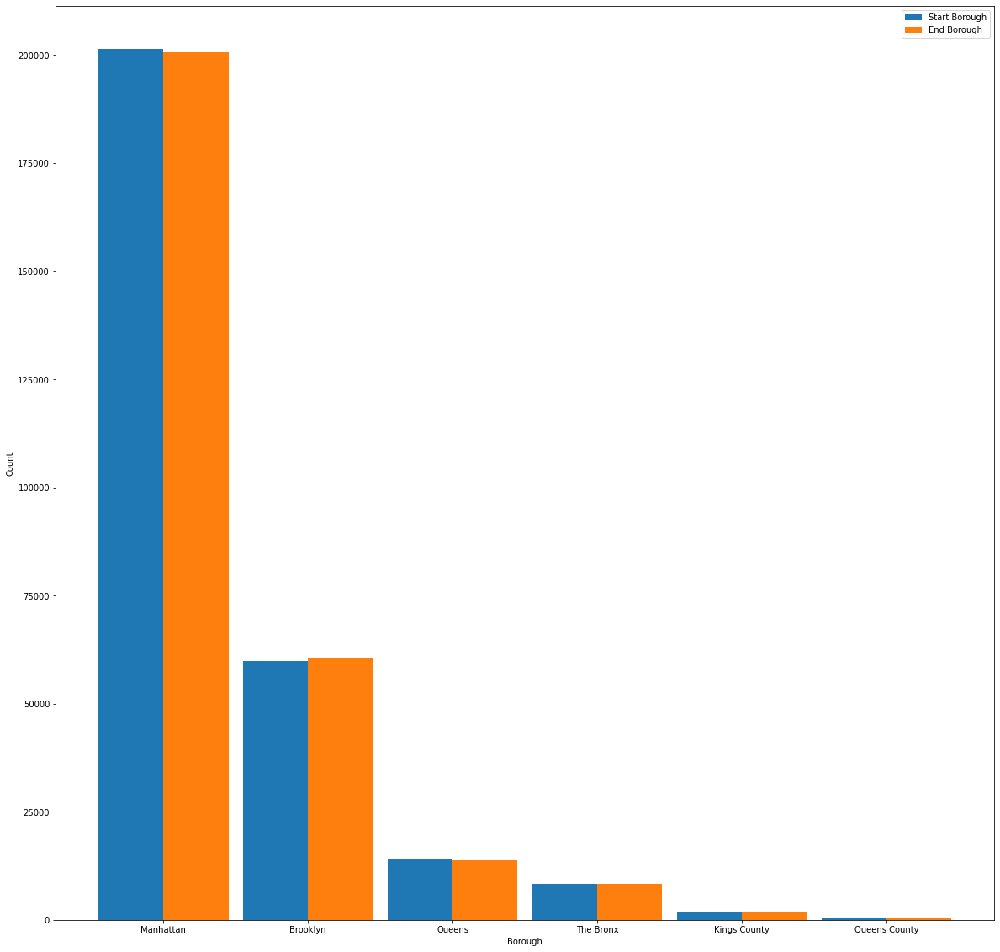

In [ ]:
fig, ax = plt.subplots()
bar_width = .45
index = np.arange(len(combined_counts.index))
ax.bar(index, combined_counts['start_count'], bar_width, label='Start Borough')
ax.bar(index + bar_width, combined_counts['end_count'], bar_width, label='End Borough')
ax.set_xlabel('Borough')
ax.set_ylabel('Count')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(combined_counts.index)
ax.legend()
plt.rcParams["figure.figsize"] = (50,20)

plt.show()

In [ ]:
#There's not that much of a difference, not even sure that it's worth doing statistical test---maybe with bigger dataset

In [ ]:
#I grouped the start locations- using count
#Exported it to a csv
#Manually use geolocator to get the suburb
#We can use this to match the location names to its suburbs

In [ ]:
export = data[['start_station_name','start_lat', 'start_lng']]
test=export.groupby('start_station_name').mean()
one=export.groupby('start_station_name').mean()[0:500]
two=export.groupby('start_station_name').mean()[500:1000]
three=export.groupby('start_station_name').mean()[1000:1615]
test

,start_lat,start_lng
start_station_name,,
1 Ave & E 110 St,40.792331,-73.938271
1 Ave & E 16 St,40.732225,-73.981656
1 Ave & E 18 St,40.733839,-73.980532
1 Ave & E 30 St,40.741455,-73.975355
1 Ave & E 39 St,40.747162,-73.971117
...,...,...
Wyckoff Av & Stanhope St,40.703538,-73.917814
Wyckoff Ave & Gates Ave,40.699861,-73.911708
Wyckoff St & Nevins St,40.683391,-73.984190


In [ ]:
one.to_csv('firstbatch.csv')
two.to_csv('secondbatch.csv')
three.to_csv('thirdbatch.csv')

In [ ]:
firstbatch = pd.read_csv('/content/drive/MyDrive/firstbatch.csv', low_memory=False)
secondbatch = pd.read_csv('/content/drive/MyDrive/secondbatch.csv', low_memory=False)
thirdbatch = pd.read_csv('/content/drive/MyDrive/thirdbatch.csv', low_memory=False)

In [ ]:
geolocator = nm(user_agent="BoroughSearch") #API
StartBorough=[]
for index, row in firstbatch.iterrows():
    location = geolocator.reverse("{}, {}".format(row['start_lat'], row['start_lng']))
    address = location.raw['address']
    startsuburb=address.get('suburb')
    StartBorough.append(startsuburb)

In [ ]:
geolocator = nm(user_agent="BoroughSearch") #API
for index, row in secondbatch.iterrows():
    location = geolocator.reverse("{}, {}".format(row['start_lat'], row['start_lng']))
    address = location.raw['address']
    startsuburb=address.get('suburb')
    StartBorough.append(startsuburb)

In [ ]:
len(StartBorough)

1000

In [ ]:
geolocator = nm(user_agent="BoroughSearch") #API
for index, row in thirdbatch.iterrows():
    location = geolocator.reverse("{}, {}".format(row['start_lat'], row['start_lng']))
    address = location.raw['address']
    startsuburb=address.get('suburb')
    StartBorough.append(startsuburb)

In [ ]:
burrdate = pd.DataFrame(StartBorough, columns = ['Boroughs'])

In [ ]:
burrdate.to_csv('outputoftest.csv')

In [ ]:
test.to_csv('test.csv')

In [ ]:
#Resulting would be the key essentially - that we use to fill in data based on street name matches

In [ ]:
resulting = pd.concat([test, burrdate], axis=1)
resulting

,start_lat,start_lng,Boroughs
1 Ave & E 110 St,40.792331,-73.938271,NaN
1 Ave & E 16 St,40.732225,-73.981656,NaN
1 Ave & E 18 St,40.733839,-73.980532,NaN
1 Ave & E 30 St,40.741455,-73.975355,NaN
1 Ave & E 39 St,40.747162,-73.971117,NaN
...,...,...,...
1610,NaN,NaN,Brooklyn
1611,NaN,NaN,Queens County
1612,NaN,NaN,Kings County
1613,NaN,NaN,Brooklyn


In [ ]:
dictionary=resulting.set_index('start_station_name')['Boroughs'].to_dict()
data['startborough'] = data['start_station_name'].map(dictionary)
data['endborough'] = data['end_station_name'].map(dictionary)

In [ ]:
nan_count = data['borough'].isna().sum().sum()
print(nan_count )

137317


In [ ]:
#Okay this is a good way to counter it however - need to fix missing stations
# There must have been a mistake in the uniqueness

In [ ]:
data

,index,ride_id,bike_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,...,lat2,long1,long2,dlat,dlong,test,miles,hour,session1,borough
0,2940534,AF5141CB7DE528C3,classic_bike,2022-09-09 18:42:34,2022-09-09 18:47:22,Lexington Ave & E 26 St,6089.08,E 20 St & 2 Ave,5971.08,40.741459,...,0.710975,-1.291252,-1.291230,-0.000097,0.000022,-0.000049,0.390870,18,Eve,NaN
1,1835333,61328A0B41D9DCD0,electric_bike,2022-09-14 19:56:53,2022-09-14 20:03:39,Meserole Ave & Manhattan Ave,5666.04,Driggs Ave & N 9 St,5411.08,40.727086,...,0.710666,-1.290723,-1.290762,-0.000156,-0.000039,-0.000078,0.626387,19,Eve,NaN
2,1621911,4B6B2F6559DE4D7A,classic_bike,2022-09-09 07:08:54,2022-09-09 07:13:04,Kent Ave & N 7 St,5489.03,India St Pier,5794.05,40.720528,...,0.710903,-1.290873,-1.290867,0.000196,0.000005,0.000098,0.773915,7,Early Morning,NaN
3,660423,30F687AE7CF75BAE,classic_bike,2022-09-30 19:04:25,2022-09-30 19:32:34,8 Ave & W 16 St,6072.11,W 20 St & 8 Ave,6224.05,40.740983,...,0.711107,-1.291573,-1.291544,0.000043,0.000029,0.000022,0.191439,19,Eve,Manhattan
4,356019,1886DFD6990E1B9B,classic_bike,2022-09-10 12:26:33,2022-09-10 12:32:53,Leonard St & Nassau Ave,5550.09,Berry St & N 8 St,5379.09,40.723957,...,0.710681,-1.290668,-1.290820,-0.000086,-0.000152,-0.000043,0.568386,12,Morning,Brooklyn
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
299995,719134,708277F1E793E55D,classic_bike,2022-09-02 11:05:01,2022-09-02 11:10:56,Carmine St & 6 Ave,5763.03,Pier 40 - Hudson River Park,5696.03,40.730386,...,0.710833,-1.291581,-1.291741,-0.000047,-0.000160,-0.000023,0.512865,11,Morning,Manhattan
299996,3028586,32C2F998DEAC3E8D,electric_bike,2022-09-19 02:19:54,2022-09-19 02:33:17,W 46 St & 11 Ave,6795.01,W 31 St & 7 Ave,6331.01,40.763414,...,0.711207,-1.291486,-1.291397,-0.000249,0.000089,-0.000124,1.019580,2,Late Night,Manhattan
299997,657170,EB8003B4BAD41226,classic_bike,2022-09-02 14:43:49,2022-09-02 14:48:50,W 70 St & Amsterdam Ave,7207.08,Amsterdam Ave & W 82 St,7360.10,40.777480,...,0.711837,-1.291245,-1.291137,0.000136,0.000108,0.000068,0.626927,14,Noon,NaN
299998,1320368,F62AFF5BA3698712,classic_bike,2022-09-13 21:05:17,2022-09-13 21:12:43,8 Ave & W 31 St,6450.05,8 Ave & W 52 St,6816.07,40.750585,...,0.711461,-1.291451,-1.291285,0.000229,0.000166,0.000115,1.033896,21,Night,Manhattan


In [ ]:
from folium import plugins
from folium.plugins import HeatMap

latitude    = data['start_lat']
longitude   = data['start_lng']
schoolheatmap = fl.Map(location=[40.730610,-73.935242],
                     zoom_start = 10)
fl.plugins.HeatMap(list(zip(latitude,
                                longitude)),
                       radius=30,
                       blur=20).add_to(schoolheatmap)
plugins.Fullscreen(position='topright').add_to(schoolheatmap)
display(schoolheatmap)

In [ ]:
from folium import plugins
from folium.plugins import HeatMap

latitude    = data['end_lat']
longitude   = data['end_lng']
schoolheatmap = fl.Map(location=[40.730610,-73.935242],
                     zoom_start = 10)
fl.plugins.HeatMap(list(zip(latitude,
                                longitude)),
                       radius=30,
                       blur=20).add_to(schoolheatmap)
plugins.Fullscreen(position='topright').add_to(schoolheatmap)
display(schoolheatmap)

In [ ]:
result1=result1.dropna(subset=['EndLatitude'])
result1=result1.dropna(subset=['EndLongitude'])

mymap = fl.Map(location = [40.767937,-73.982155 ], 
                   width = 950, 
                   height = 550,
                   zoom_start = 11.3, 
                   tiles = 'openstreetmap')
fl.TileLayer('Stamen Terrain').add_to(mymap)
fl.TileLayer('Stamen Toner').add_to(mymap)
fl.TileLayer('Stamen Water Color').add_to(mymap)
fl.TileLayer('cartodbpositron').add_to(mymap)
fl.TileLayer('cartodbdark_matter').add_to(mymap)
fl.LayerControl().add_to(mymap)

for _, row in result1.iterrows():
    fl.CircleMarker([row['StartLatitude'], row['StartLongitude']],
                        radius=4,
                        fill_color="#3db7e4", # divvy color
                       ).add_to(mymap)

    fl.CircleMarker([row['EndLatitude'], row['EndLongitude']],
                        radius=4,
                        fill_color="red", # divvy color
                       ).add_to(mymap)

    fl.PolyLine([[row['StartLatitude'], row['StartLongitude']], 
                     [row['EndLatitude'], row['EndLongitude']]], line_opacity = 0.1, color='black',line_weight=1).add_to(mymap),

                 
mymap.save('index.html')

In [ ]:
#Get the Start Suburbs/Boroughs   
#The Bronx
#Queens
#Brooklyn
#Manhattan
#StatenIsland
geolocator = nm(user_agent="BoroughSearch") #API
StartBorough=[]
for index, row in data.iterrows():
    location = geolocator.reverse("{}, {}".format(row['start_lat'], row['start_lng']))
    address = location.raw['address']
    startsuburb=address.get('suburb')
    StartBorough.append(startsuburb)
    #with open('StartBorough.csv', 'w') as f:
    # using csv.writer method from CSV package
        ##write.writerow(StartBorough)


 #Get the End Suburbs/Boroughs   
EndBorough=[]
for index, row in data.iterrows():
    location = geolocator.reverse("{}, {}".format(row['end_lat'], row['end_lng']))
    address = location.raw['address']
    endsuburb=address.get('suburb', '')
    EndBorough.append(startsuburb)
    #with open('EndBorough.csv', 'w') as f:
    # using csv.writer method from CSV package
        #write = csv.writer(f)
        #write.writerow(EndBorough)

In [ ]:
#Start Geolocation Method 2
from tqdm.auto import tqdm
tqdm.pandas()

data['startgeom'] = data.apply(lambda row: (str(row.start_lat),str(row.start_lng)),axis=1) #Start Location Long+Lat
data['endgeom'] = data.apply(lambda row: (str(row.end_lat),str(row.end_lng)),axis=1) #End Location Long+Lat
locator = nm(user_agent='myGeocoder', timeout=10)
rgeocode = RateLimiter(locator.reverse, min_delay_seconds=0.001)
#season.progress_apply(rgeocode)

KeyboardInterrupt: ignored